In [1]:
import os
import re
import sys
from os import listdir
from os.path import isfile, join
from pathlib import Path

import cv2 as cv
import h5py
import matplotlib.pyplot as plt
import numpy as np
import skimage
from skimage import exposure, io
from skimage.util import img_as_ubyte
from tqdm.notebook import tqdm, trange

In [2]:
p_dir = (Path().cwd().parents[0]).absolute()

In [3]:
%load_ext autoreload
%autoreload 2

module_path = str(p_dir / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

import utils as my_utils
import affine
import transform

# Import tof-sims data

In [22]:
from skimage.transform import resize
from sklearn.neighbors import NearestNeighbors

h5_data_dir = p_dir / "data" / "h5"


def get_imgs(experiment, name):
    with h5py.File(h5_data_dir / f"{experiment}.hdf5", "r") as f:
        imgs = f[name][:]
        labels = list(f[name].attrs["markers"])
    return imgs, labels


def get_imgs_SIMS(experiment, name):
    with h5py.File(h5_data_dir / f"{experiment}.hdf5", "r") as f:
        imgs = f[name][:]
        labels = list(f[name].attrs["labels"])
        fov = f[name].attrs["fov"]
    return imgs, labels, fov


def get_imgs_index(imgs, index_list, fov_dim):

    imgs_subset = imgs[index_list, :, :]
    img_combined = np.sum(imgs_subset, axis=0)
    img_downscale = resize(img_combined, (fov_dim, fov_dim), anti_aliasing=False)
    return img_downscale

In [43]:
experiment = "tonsil"
core = "DonorE"
datasets = [
    core + "_1",
    core + "_2",
    core + "_3",
    core + "_4",
    core + "_5",
    core + "_6",
]
# datasets = [
#     core + "_4",
# ]

imgs_nuclei_downscale = []
fovs = []
# fov_add = [58, 58, 48, 48, 48]
fov_add = [65, 65, 65, 65, 53, 68]
# fov_add = [48]

for i, name in enumerate(datasets):
    try:
        imgs, labels, fov = get_imgs_SIMS(experiment, name)
    except:
        continue

    print(fov)
    fov = int(fov) + fov_add[i]
    img_nuclei_downscale = get_imgs_index(imgs, [18], fov_dim=fov)
    p2, p98 = np.percentile(img_nuclei_downscale, (10, 99.9))
    img_nuclei_downscale = exposure.rescale_intensity(
        img_nuclei_downscale, in_range=(p2, p98), out_range=(0, 255)
    )
    img_nuclei_downscale = img_nuclei_downscale.astype(np.uint8)
    imgs_nuclei_downscale.append(img_nuclei_downscale)
    fovs.append(fov)

382.8125
382.8125
382.8125
382.8125
320.3125
390.625


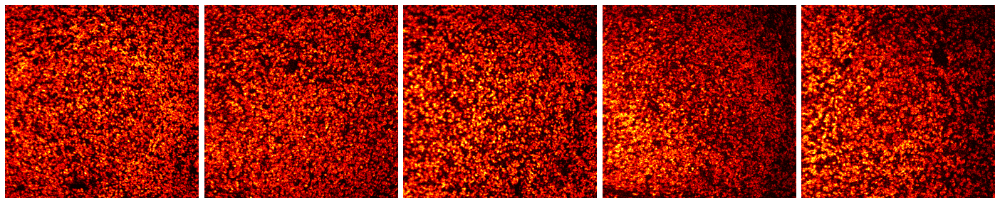

In [44]:
fig, ax = plt.subplots(1, 5, figsize=(25, 5))
ax = ax.flatten()
for i in range(len(ax)):
    try:
        ax[i].imshow(imgs_nuclei_downscale[i], cmap="hot")
    except:
        pass
    ax[i].axis("off")
fig.subplots_adjust(wspace=0.01, hspace=0.01)
plt.show()

# Import IMC data 

## Import large region

In [45]:
from skimage.transform import rotate

def get_imgs(experiment, name):
    with h5py.File(h5_data_dir / f"{experiment}.hdf5", "r") as f:
        imgs = f[name][:]
        labels = list(f[name].attrs["markers"])
    return imgs, labels


def contrast_stretching(img):
    # Contrast stretching
    p2, p98 = np.percentile(img, (2, 93))
    img_rescale = exposure.rescale_intensity(
        img, in_range=(p2, p98), out_range=(0, 255)
    ).astype(np.uint8)
    return img_rescale

In [46]:
imgs, markers = get_imgs(experiment + " " + core, "IMC")
# subset = ["DNA1", "DNA2", 'H3K27me3']
subset = ["DNA1", "DNA2"]
# subset = ["DNA1", "DNA2", 'Ki67', 'EZH2', 'H3K27me3']

img_dapi = np.max(contrast_stretching(imgs[[markers.index(marker) for marker in subset]]), axis=0)
img_dapi = contrast_stretching(img_dapi)

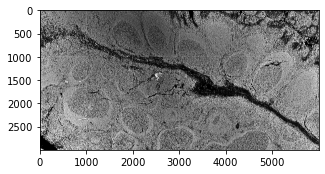

In [47]:
rotation = 90

img_h3 = rotate(img_dapi, rotation, resize=True)
img_h3 = img_as_ubyte(img_h3)

fig, ax = plt.subplots(figsize=(5, 20))
ax.imshow(img_h3, cmap="gray")
plt.show()

In [48]:
# import napari

# napari.view_image(np.stack(imgs), channel_axis=0, name=markers, visible=False)

# Template matching between IMC and Tof-sims data

## Match template 

In [49]:
from typing import Tuple

from skimage.feature import match_template
from skimage.transform import rescale


def match_region(
    source: np.ndarray, template: np.ndarray, show: bool = True, path=None
) -> Tuple[np.ndarray, Tuple[int, int, int, int]]:
    """
    Template matching between source and template
    Return cropped source matching template and bbox of crop region
    """

    # Use template matching
    result = match_template(source, template)

    # Get maximum point of correlation
    ij = np.unravel_index(np.argmax(result), result.shape)
    x, y = ij[::-1]
    h_region, w_region = template.shape

    if show:
        # Plot result
        fig, ax = plt.subplots(figsize=(10, 10))
        ax.imshow(source, cmap=plt.cm.gray)
        ax.set_axis_off()

        # highlight matched region
        rect = plt.Rectangle(
            (x, y), w_region, h_region, edgecolor="r", facecolor="none", lw=3
        )
        ax.add_patch(rect)

    img_crop = source[y : y + h_region, x : x + w_region]

    return img_crop, (y, h_region, x, w_region)

In [50]:
# napari.view_image(img_h3)

In [51]:
regions_dict = {
    "DonorA": [
        [3600, 4400, 700, 1300],
        [2800, 3500, 1100, 1800],
        [1100, 1900, 500, 1250],
        [600, 1300, 1200, 1900],
        [100, 650, 600, 1250],
    ],
    "DonorE": [
        [900, 1600, 500, 1250],
        [600, 1200, 3000, 3700],
        [2000, 2700, 1900, 2500],
        [200, 900, 1750, 2300],
        [2000, 2600, 3100, 3800],
        [700, 1400, 4050, 4700],
    ],
}

# regions_dict = {
#     "DonorA": [
#         [500, 1075, 1400, 2000],
#     ],
# }
regions = regions_dict[core]

imgs_h3_cropped = [
    img_h3[row_min:row_max, col_min:col_max]
    for row_min, row_max, col_min, col_max in regions
]

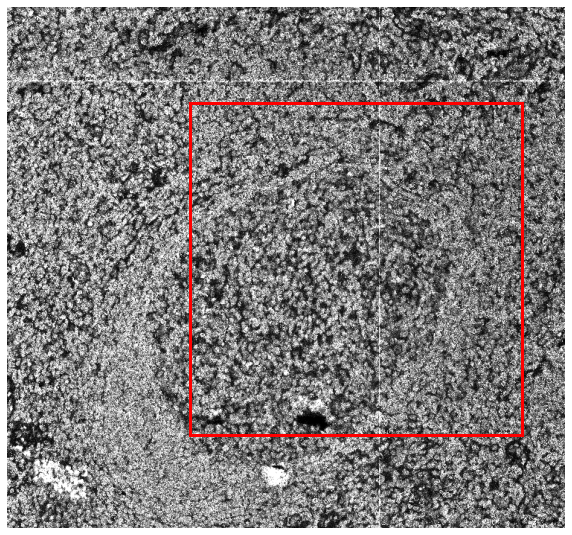

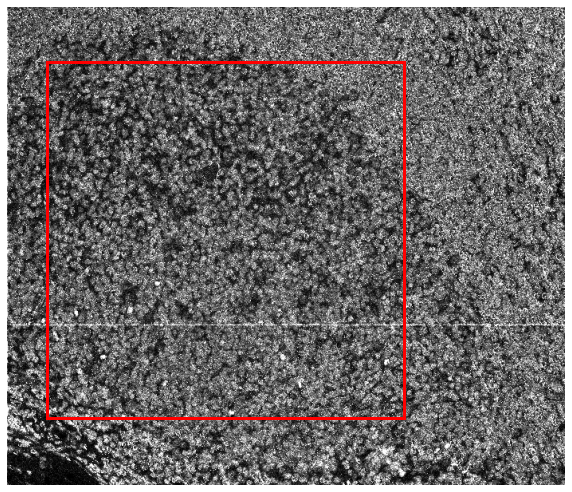

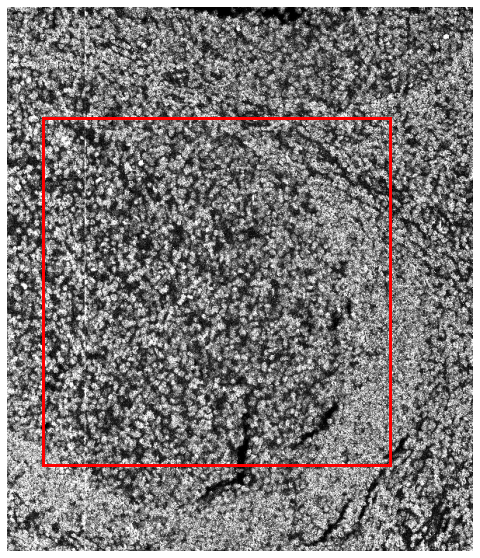

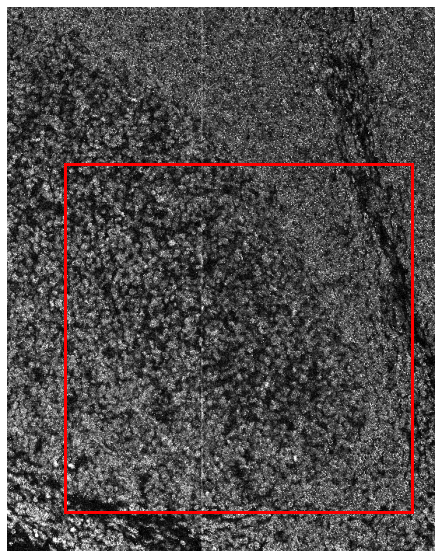

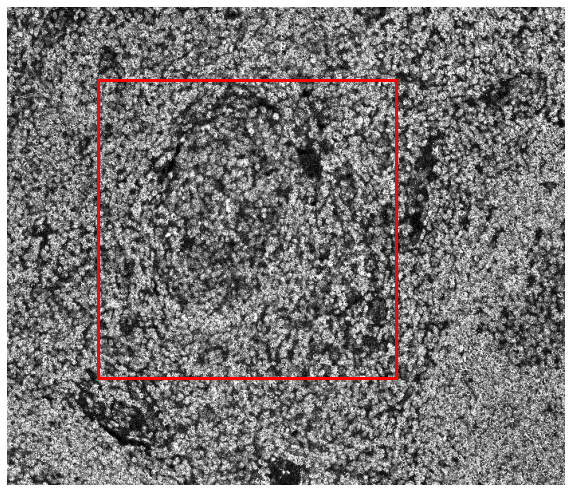

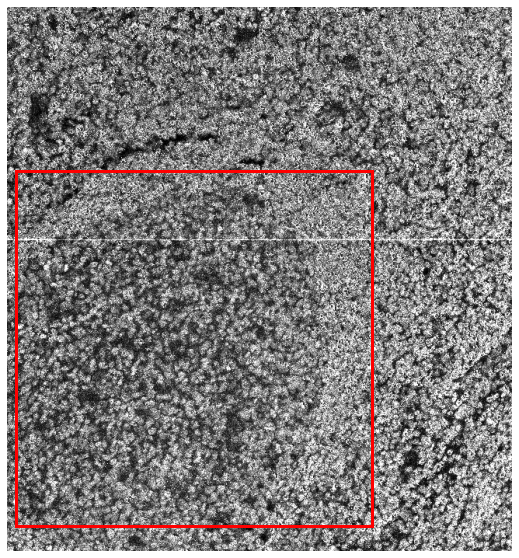

In [52]:
imgs_h3_crop, bbox = map(
    list,
    zip(
        *[
            match_region(imgs_h3_cropped[i], img)
            for i, img in enumerate(imgs_nuclei_downscale)
        ]
    ),
)
plt.show()

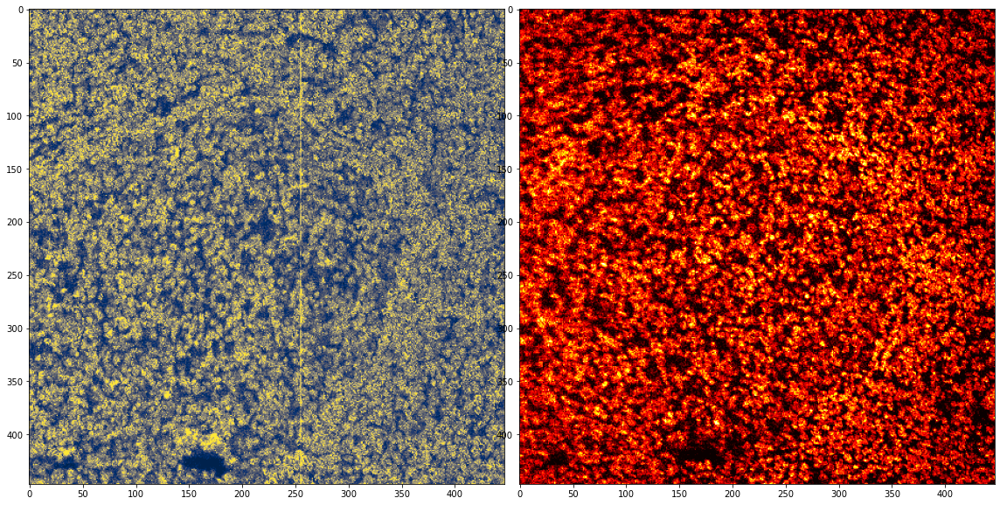

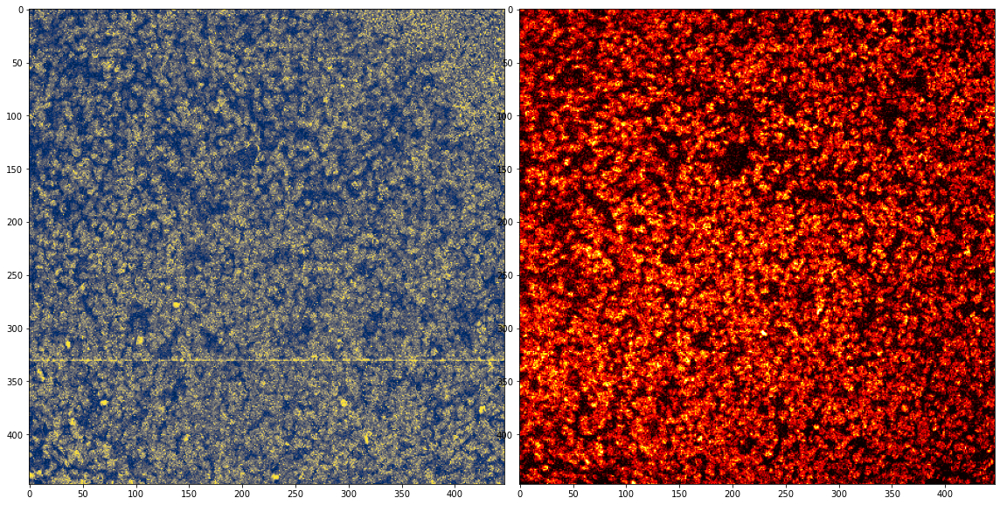

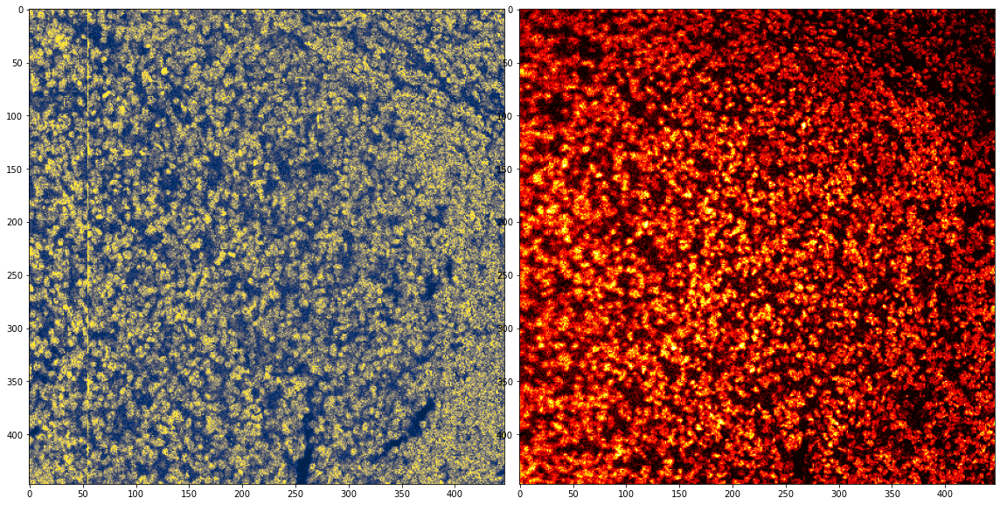

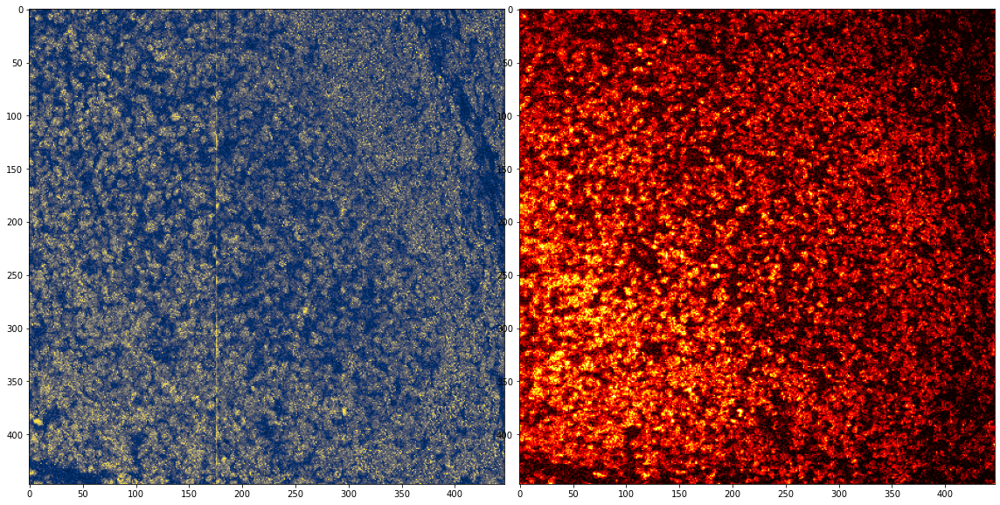

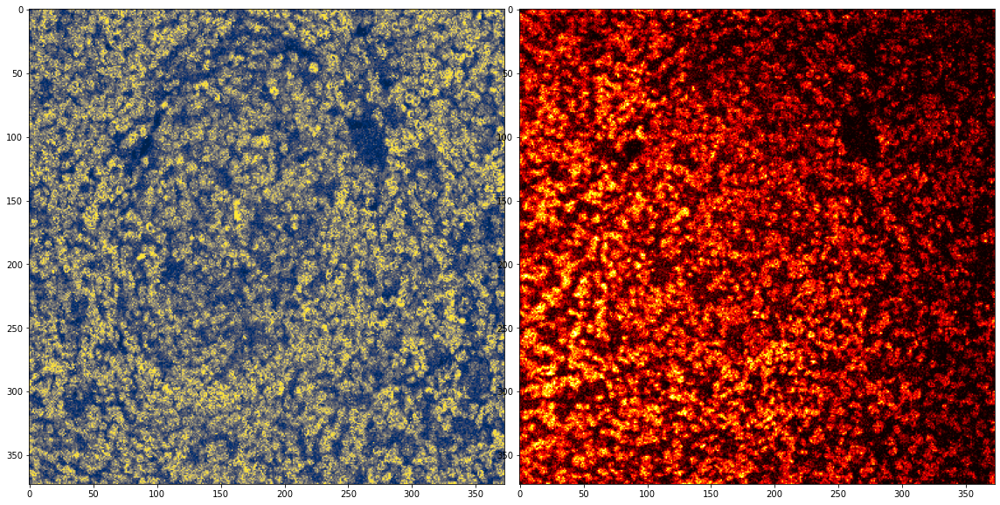

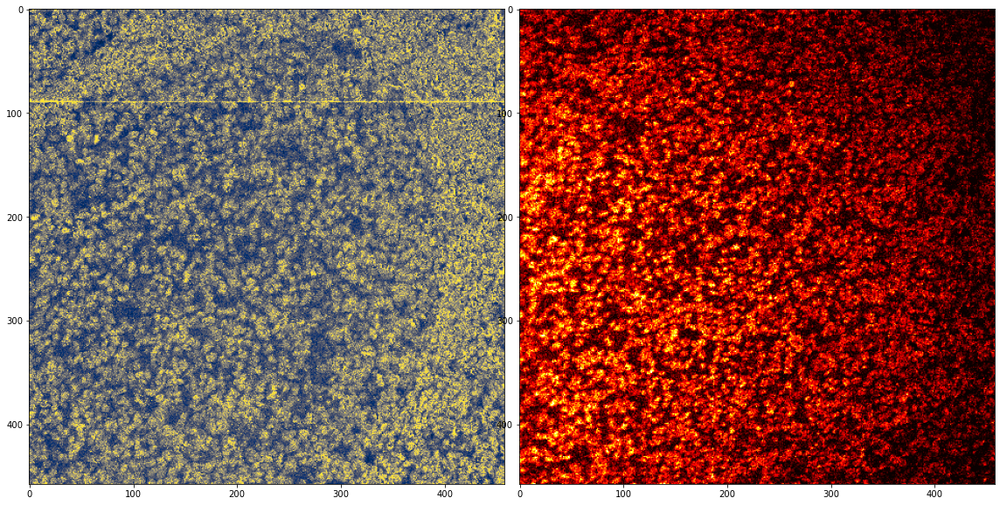

In [53]:
for i in range(len(imgs_h3_crop)):
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))
    ax[0].imshow(imgs_h3_crop[i], cmap="cividis")
    ax[1].imshow(imgs_nuclei_downscale[i], cmap="hot")
    fig.subplots_adjust(wspace=0.01)
    plt.show()

## Calculate rotation

In [54]:
from skimage.registration import phase_cross_correlation
from skimage.transform import rescale, rotate, warp_polar


def get_rotation(source: np.ndarray, template: np.ndarray, radius: int = 720) -> int:
    """
    Calculate rotation angle between source and template in degrees
    """

    image_polar = warp_polar(source, radius=radius)
    rotated_polar = warp_polar(template, radius=radius)

    shifts, error, phasediff = phase_cross_correlation(
        image_polar, rotated_polar, upsample_factor=10
    )
    print("Recovered value for counterclockwise rotation: " f"{shifts[0]}")

    return shifts[0]

In [55]:
rotations = [
    get_rotation(img1, img2) for img1, img2 in zip(imgs_h3_crop, imgs_nuclei_downscale)
]
mean_rotation = np.mean(rotations)

Recovered value for counterclockwise rotation: 0.2
Recovered value for counterclockwise rotation: 0.2
Recovered value for counterclockwise rotation: 0.1
Recovered value for counterclockwise rotation: 0.2
Recovered value for counterclockwise rotation: 0.0
Recovered value for counterclockwise rotation: 0.2


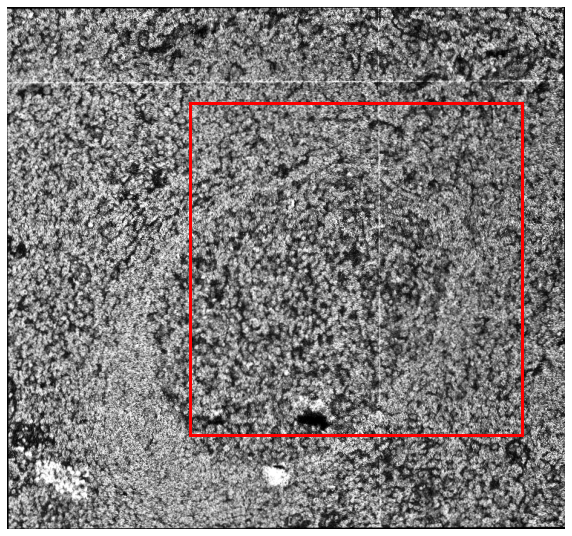

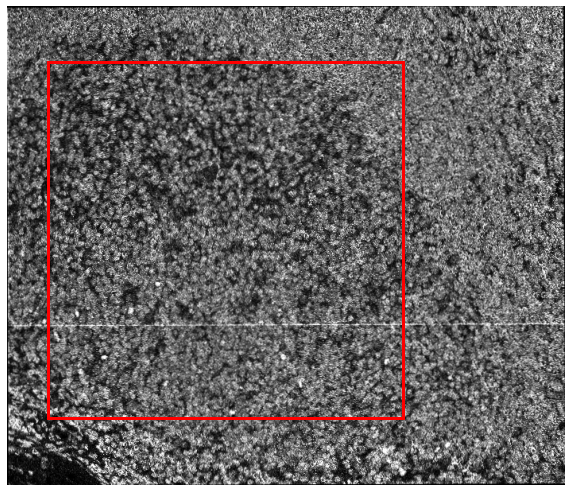

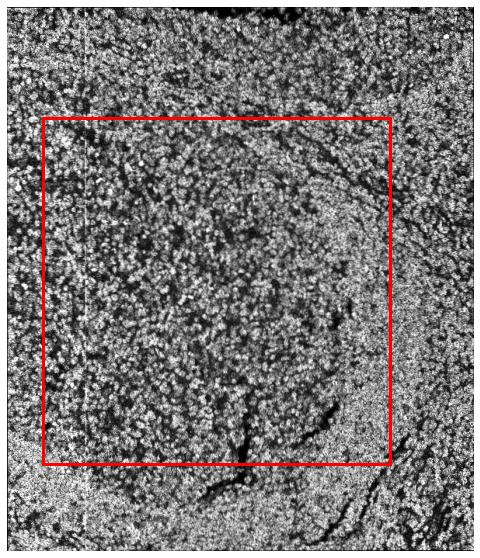

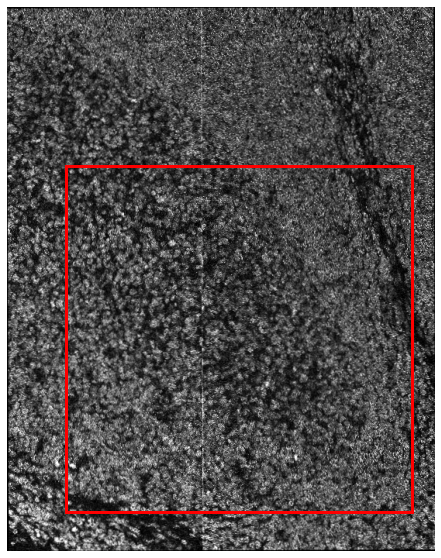

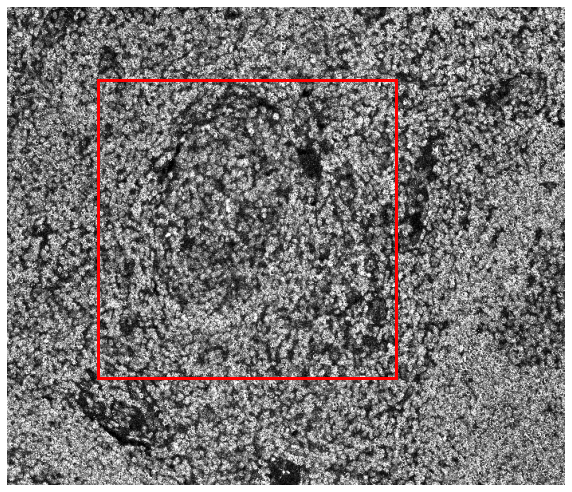

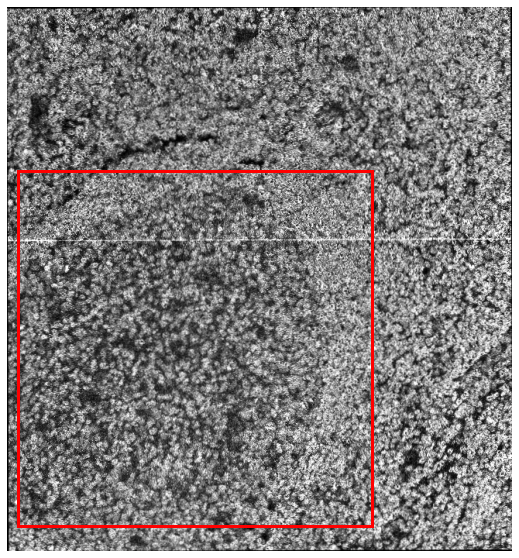

In [56]:
imgs_h3_r_crop = []
bboxs_r = []

for i, img in enumerate(imgs_nuclei_downscale):
    res, bbox_r = match_region(rotate(imgs_h3_cropped[i], rotations[i], resize=True), img)
    imgs_h3_r_crop.append(res)
    bboxs_r.append(bbox_r)

# Affine transformation check

Getting key points


C:\Users\thu71\Anaconda3\envs\new_codex\lib\site-packages\fishspot\filter.py:12: FutureWarning: `selem` is a deprecated argument name for `white_tophat`. It will be removed in version 1.0. Please use `footprint` instead.
  return skimage_white_tophat(image, selem=selem)


FIXED image: found 4094 key points
MOVING image: found 4592 key points
MATCHED points: found 737 matched points
Getting key points
FIXED image: found 4307 key points
MOVING image: found 4592 key points
MATCHED points: found 299 matched points
Getting key points
FIXED image: found 3872 key points
MOVING image: found 3935 key points
MATCHED points: found 2038 matched points
Getting key points
FIXED image: found 4577 key points
MOVING image: found 4807 key points
MATCHED points: found 302 matched points
Getting key points
FIXED image: found 2810 key points
MOVING image: found 3085 key points
MATCHED points: found 115 matched points
Getting key points
FIXED image: found 4679 key points
MOVING image: found 4819 key points
MATCHED points: found 428 matched points


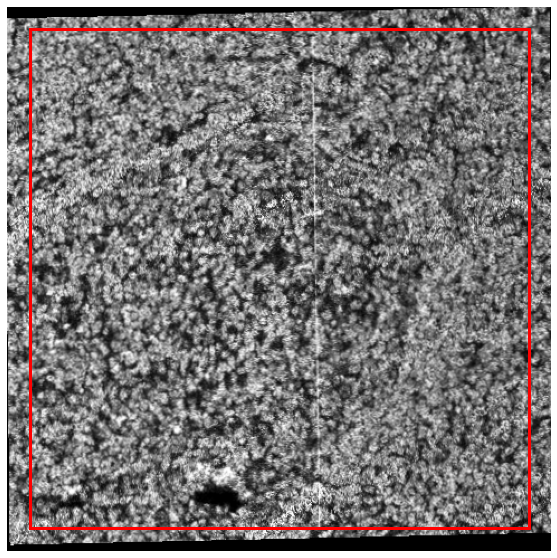

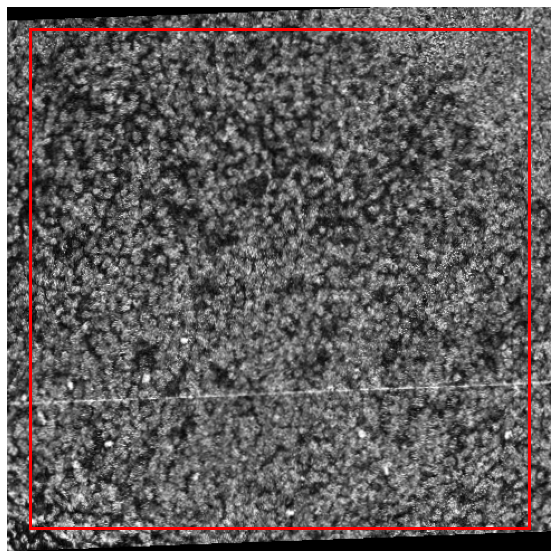

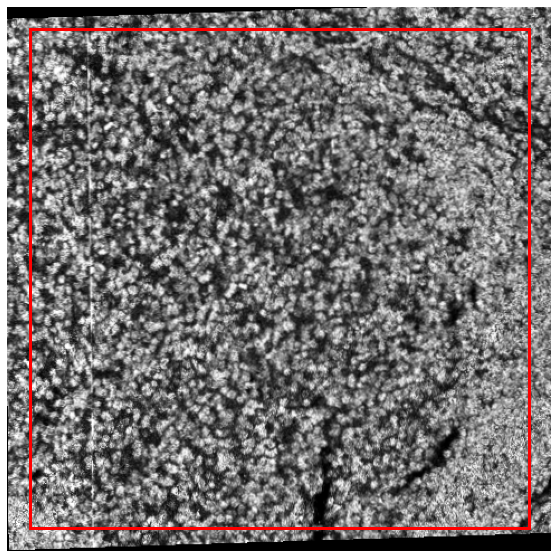

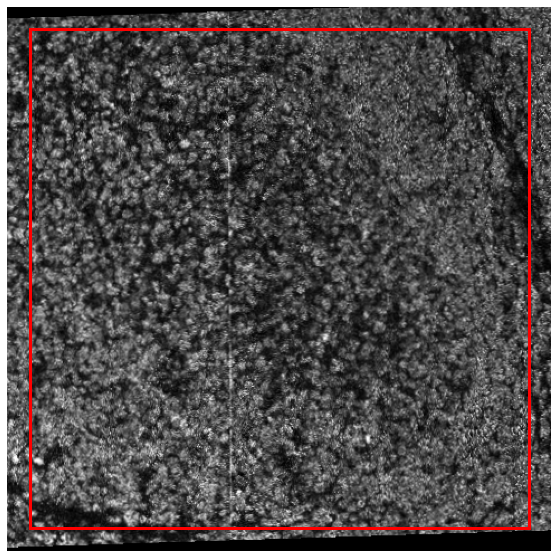

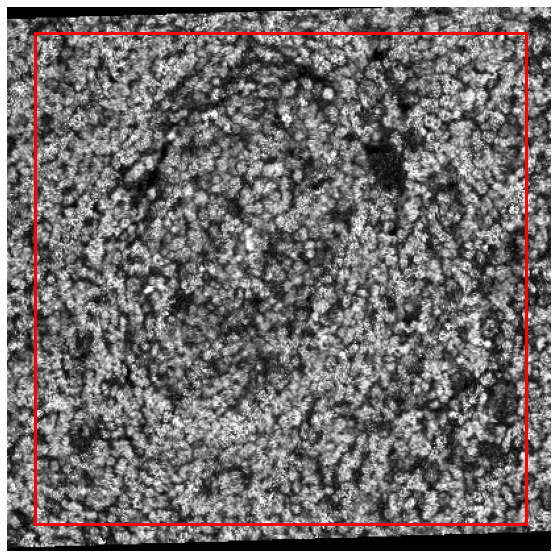

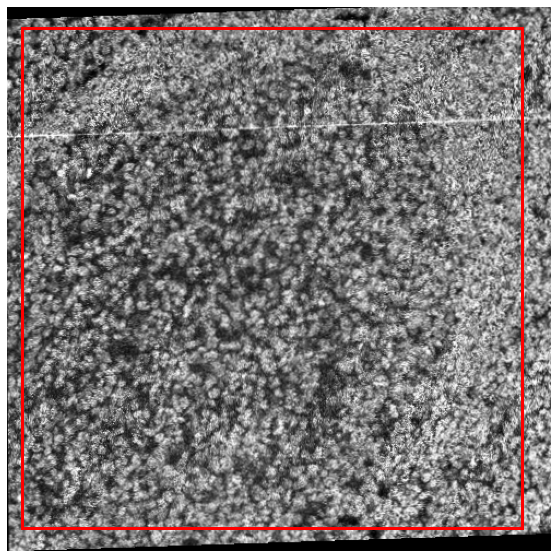

In [57]:
min_radius = 3
max_radius = 10
match_threshold=0.4
pad = 20

imgs_h3_r_t_crop = []
bboxs_r_t = []
affs = []

for i, img in enumerate(imgs_nuclei_downscale):
    img2 = img_as_ubyte(imgs_h3_r_crop[i])
    img1 = img_as_ubyte(img)
    img_h3_rotate = rotate(imgs_h3_cropped[i], rotations[i], resize=True)
    
    # Get affine transformation 
    aff = affine.ransac_affine(img1, img2, min_radius, max_radius, match_threshold)
    # if np.allclose(aff,np.eye(3)):
    #     aff = affs[i-1]
        
    # Affine transform on crop
    res2 = transform.apply_global_affine(img2, img2, aff)
    
    # Affine transform on enlarged crop then match
    y, h_region, x, w_region = bboxs_r[i]
    y = y - pad
    h_region = h_region + 2*pad
    x = x - pad
    w_region = w_region + 2*pad
    y = 0 if y < 0 else y
    x = 0 if x < 0 else x
    img3 = img_h3_rotate[y : y + h_region, x : x + w_region]
    img3_aligned = transform.apply_global_affine(img3, img3, aff)
    res3, bbox_r = match_region(img3_aligned, img1, show=True)
    
    imgs_h3_r_t_crop.append(res3)
    bboxs_r_t.append(bbox_r)
    affs.append(aff)
    

In [58]:
import napari
i = 0

viewer = napari.view_image(imgs_h3_r_t_crop[i])
viewer.add_image(imgs_nuclei_downscale[i])

<Image layer 'Image [1]' at 0x228050784f0>

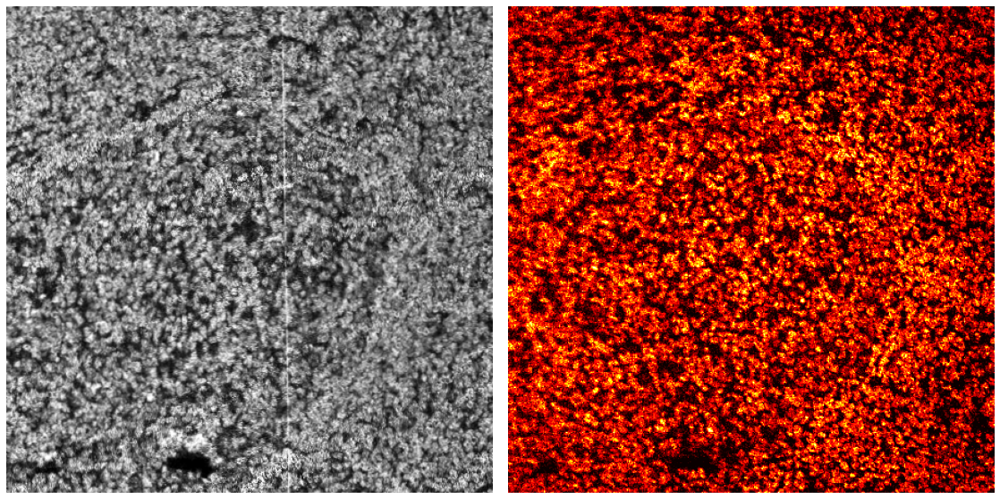

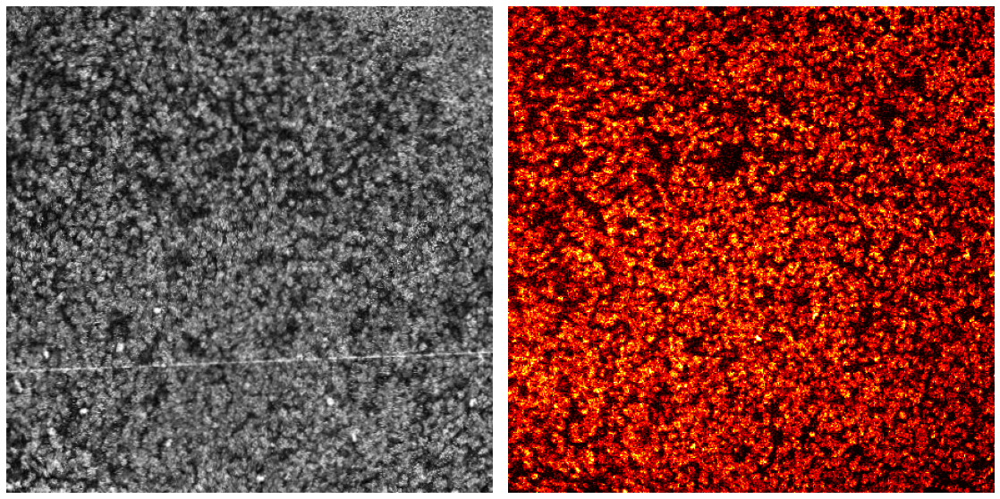

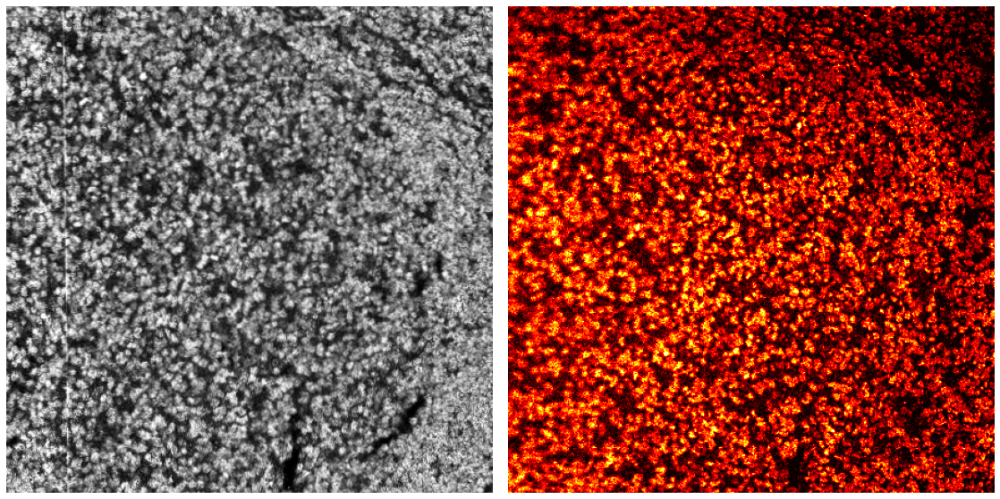

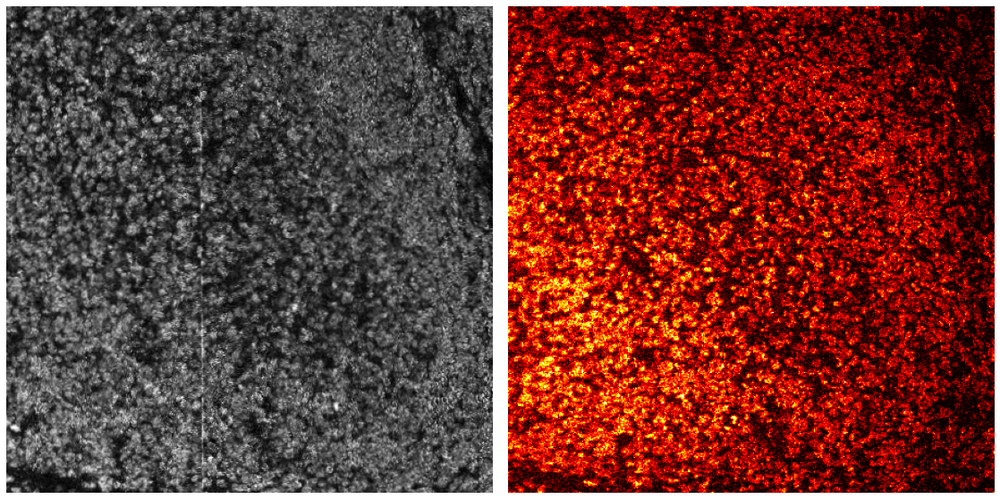

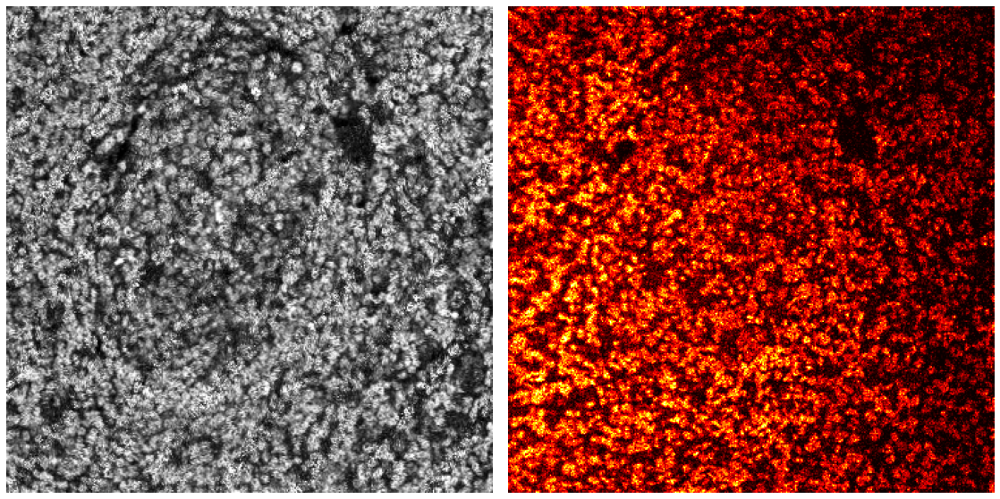

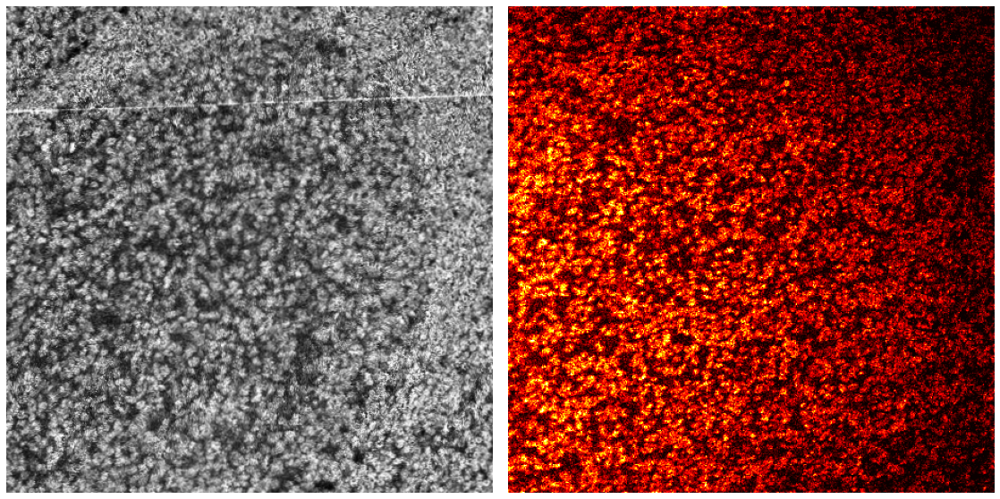

In [60]:
for i in range(len(imgs_h3_r_crop)):
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))
    ax[0].imshow(imgs_h3_r_t_crop[i], cmap="gray")
    ax[1].imshow(imgs_nuclei_downscale[i], cmap="hot")
    ax[0].axis("off")
    ax[1].axis("off")
    fig.subplots_adjust(wspace=0.01)
    plt.show()

In [22]:
# match_info_dir = p_dir / "data" / "match"

# for i, dataset in enumerate(datasets):
#     info = {
#         "rotation_init": rotation,
#         "rotation_adjust": rotations[i],
#         "bbox": bboxs_r[i],
#         "dim": fovs[i],
#         "img_region": regions[i],
#     }
#     my_utils.save_pkl(match_info_dir / f"{experiment}_{dataset}.pickle", info)

In [71]:
match_info_dir = p_dir / "data" / "match"

for i, dataset in enumerate(datasets):
    info = {
        "rotation_init": rotation,
        "rotation_adjust": rotations[i],
        "bbox": bboxs_r[i],
        "bbox_aff": bboxs_r_t[i],
        "pad": pad,
        "dim": fovs[i],
        "border": 0,
        "affine": affs[i],
        "img_region": regions[i],
    }
    my_utils.save_pkl(match_info_dir / f"{experiment}_{dataset}.pickle", info)